# Plot Figure 1, which illustrates the the forward Smoothed Dirichlet Diffusion process 

In [ ]:
import os
import re
import click
import tqdm
import pickle
import numpy as np
import random
import torch
import PIL.Image
import dnnlib
import matplotlib.pyplot as plt
from torch_utils import distributed as dist
from torch.distributions import Gamma
from torch.distributions import Beta
from training import loss
import json

MIN = torch.finfo(torch.float32).tiny
EPS = torch.finfo(torch.float32).eps
def log_gamma(alpha):
    return torch.log(torch._standard_gamma(alpha))


## Define sigmoid diffusion noise schedule

tensor([0.0000, 0.0500, 0.1000, 0.1500, 0.2000, 0.2500, 0.3000, 0.3500, 0.4000,
        0.4500, 0.5000, 0.5500, 0.6000, 0.6500, 0.7000, 0.7500, 0.8000, 0.8500,
        0.9000, 0.9500, 1.0000], device='cuda:0')
tensor([9.9995e-01, 9.9986e-01, 9.9955e-01, 9.9857e-01, 9.9550e-01, 9.8594e-01,
        9.5689e-01, 8.7545e-01, 6.8997e-01, 4.1338e-01, 1.8243e-01, 6.5989e-02,
        2.1881e-02, 7.0336e-03, 2.2378e-03, 7.0967e-04, 2.2482e-04, 7.1196e-05,
        2.2544e-05, 7.1385e-06, 2.2603e-06], device='cuda:0')


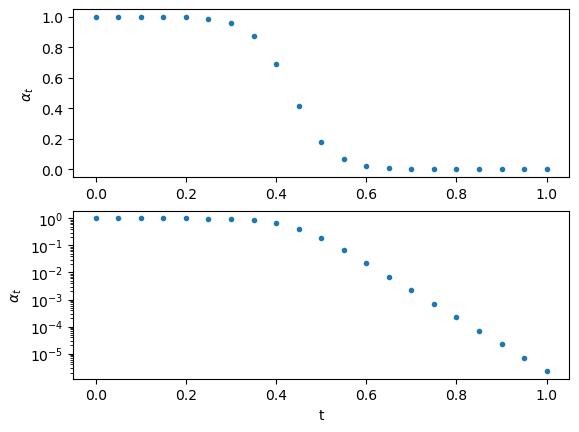

In [ ]:
device='cuda'

num_steps=20
eta = 10000

Scale = 0.39
Shift = 0.6


sigmoid_start=10
sigmoid_end = -13
sigmoid_power = 1

t_steps = torch.arange(num_steps+1, device=device)/num_steps
logit_alpha = sigmoid_start + (sigmoid_end-sigmoid_start) * (t_steps**sigmoid_power)

alpha = logit_alpha.sigmoid()

print(t_steps)
print(alpha)
plt.subplot(2,1,1)
plt.plot(t_steps.cpu(),alpha.cpu(),'.')
plt.ylabel(r'$\alpha_t$')
plt.subplot(2,1,2)
plt.semilogy(t_steps.cpu(),alpha.cpu(),'.')
plt.xlabel('t')
plt.ylabel(r'$\alpha_t$')
plt.show()

## Illustration of Forward Smoothed Dirichlet Diffusion

torch.Size([128, 1, 256, 256])


/tmp/ipykernel_219079/1236681054.py:69: DeprecationWarning: 'mode' parameter is deprecated and will be removed in Pillow 13 (2026-10-15)
  image_grid = PIL.Image.fromarray(grid, 'RGB')


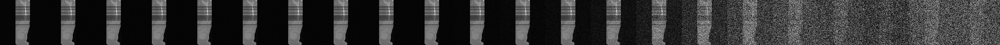

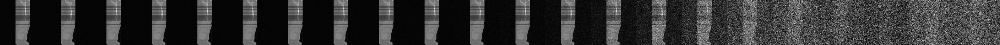

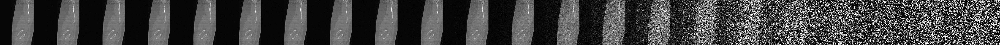

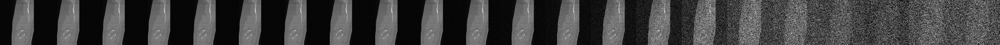

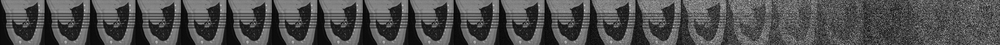

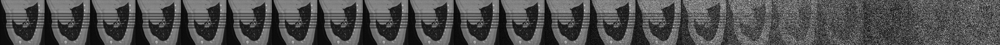

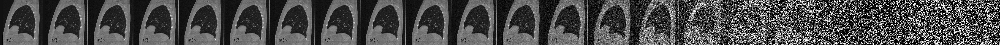

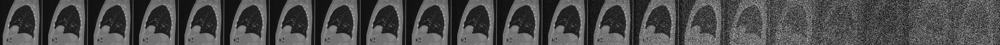

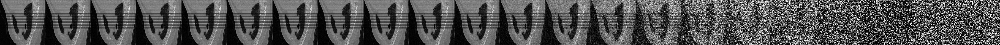

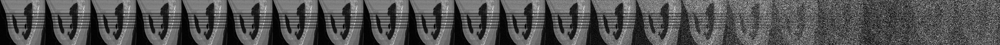

In [ ]:

from training.dataset import ImageFolderDataset,NPYDataset
from torch_utils import misc

# axial, coronal,sagittal
# dataset = NPYDataset('datasets/CTHD/train/full_dose_slices_npy_256/sagittal')
# dataset = NPYDataset('datasets/LDCT/train/full_dose_slices_npy_256/axial')
# dataset = NPYDataset('datasets/LIDC/train/full_dose_slices_npy_256/axial')

dataset = ImageFolderDataset('datasets/cifar10-32x32.zip', use_labels=False)

dataset_sampler = misc.InfiniteSampler(dataset=dataset, rank=0, num_replicas=1)
dataset_iterator = iter(torch.utils.data.DataLoader(dataset=dataset, sampler=dataset_sampler, batch_size=128))
x0,y = next(dataset_iterator)
x0 = x0.to(device).to(torch.float32)/255.0
lambda_penalty = 2e-6
delta = 0.01 
print(x0.shape)
for idx in (0,9,14,20,23):
    xt = []
    xt.append(x0[idx])
    x0_scale_shift = x0*Scale+Shift
    for t in range(num_steps+1):    
        log_u = log_gamma(eta * alpha[t] * x0_scale_shift[idx])
        log_v = log_gamma(eta - eta * alpha[t] * x0_scale_shift[idx])
        logit_x_t = log_u - log_v.to(device = device) 

        diffs_sq = torch.zeros_like(logit_x_t[:, 0, :])

        num_channels = logit_x_t.shape[1]
        
        for i in range(num_channels - 1 ):
            
            diff = logit_x_t[:, i+1, :] - logit_x_t[:, i, :]
            # diff = torch.log((logit_x_t[:, i+1, :]) + EPS) - torch.log((logit_x_t[:, i, :]) + EPS)
            # diff = logit_x_t[:, i+1, :] - 2 * logit_x_t[:, i,:] + logit_x_t[:, i-1, :]
            diffs_sq += diff**2

        penalty = lambda_penalty * diffs_sq
        E_exp_penalty = torch.mean(torch.exp(penalty))
    
        logit_x_t = (logit_x_t / E_exp_penalty)  
    
        x_t = ((torch.sigmoid(logit_x_t) / (alpha[t])) - Shift) / Scale
        xt.append(x_t)
        
    xt_np = [(i * 255.0).clip(0, 255).to(torch.uint8).permute(1, 2, 0).cpu().numpy() for i in xt]
    n = len(xt_np)
    m = int(np.ceil(np.sqrt(n)))
    w = h = x0.shape[2]
    grid = np.zeros((h, n*w, 3), dtype=np.uint8)
    for i, i_np in enumerate(xt_np):
        x = i
        y = 0
        grid[y*h:(y+1)*h, x*w:(x+1)*w, :] = i_np
        image_grid = PIL.Image.fromarray(grid, 'RGB')
    image_grid.save(f'plots/forward{idx}.png')
    display(image_grid)
    resized_image_grid = image_grid.resize((128*n,128))
    display(resized_image_grid)

# Plot Figure 2, which illustrates the the reverse Smoothed Dirichlet  diffusion process

## Uncomment and run the line below to generate 100 random images in parral with 1000 steps, modify the number of GPUs accordingly

## Define the reverse Smoothed Dirichlet diffusion sampler

In [ ]:
def sdd_sampler(
    net, latents, class_labels=None, randn_like=torch.randn_like,
    num_steps=None, alpha_min=None, eta=None, sigmoid_start=None, sigmoid_end=None, sigmoid_power=None, start_step=None,Scale=None,Shift=None
):
    
    
    lambda_penalty = 2e-6

    if num_steps>350:
        step_indices = torch.arange(num_steps, dtype=torch.float64, device=latents.device)
        t_steps = 1-step_indices / (num_steps - 1)*(1-1e-5)
        t_steps = torch.cat([net.round_sigma(t_steps), torch.zeros_like(t_steps[:1])])
        logit_alpha = sigmoid_start + (sigmoid_end-sigmoid_start) * (t_steps**sigmoid_power)
        alpha = logit_alpha.sigmoid()
    else:
        step_indices = torch.arange(num_steps+1, dtype=torch.float64, device=latents.device)
        log_pi = (sigmoid_start + (sigmoid_end - sigmoid_start) * (torch.tensor(1, dtype=torch.float64, device=latents.device)**sigmoid_power)).sigmoid().log() / (num_steps)
        #log_pi = torch.tensor(2e-6, device=latents.device).log()/(num_steps)
        alpha = (step_indices*log_pi).exp()
        alpha = torch.flip(alpha, [0])
        logit_alpha = alpha.logit()
    
    alpha_min = alpha_min if alpha_min is not None else alpha[0]

    log_u = log_gamma( (eta * alpha_min * latents).to(torch.float32) ).to(torch.float64)
    log_v = log_gamma( (eta - eta * alpha_min * latents).to(torch.float32) ).to(torch.float64)
    x_next = (log_u - log_v).to(latents.device)

    diffs_sq = torch.zeros_like(x_next[:, 0, :])  

    num_channels = x_next.shape[1]

    for i in range(num_channels - 1):
        
        diff = x_next[:, i+1, :] - x_next[:, i, :]
        # diff = torch.log(torch.abs(x_next[:, i+1, :]) + EPS) - torch.log(torch.abs(x_next[:, i, :]) + EPS)
        # diff = x_next[:, i+1, :] - 2 * x_next[:, i,:] + x_next[:, i-1, :]
        diffs_sq += diff**2

    penalty = lambda_penalty * diffs_sq
    E_exp_penalty = torch.mean(torch.exp(penalty)).clamp_min(EPS)

    x_next = (x_next/E_exp_penalty)  

    ims = []
    im_xhats = []

    ims.append( ((torch.sigmoid(x_next)/(alpha_min)-Shift)/Scale-0.5)/0.5)
    im_xhats.append(((latents - Shift) / Scale-0.5)/0.5) 

    for i, (logit_alpha_cur,logit_alpha_next) in enumerate(zip(logit_alpha[:-1], logit_alpha[1:])): # 0, ..., N-1
        x_cur = x_next
        alpha_cur = logit_alpha_cur.sigmoid()
        alpha_next = logit_alpha_next.sigmoid()

        xmin = Shift
        xmax = Shift + Scale
        xmean = Shift+Scale/2.0

        E1 = 1.0/(eta*alpha_cur*Scale)*((eta * alpha_cur * xmax).lgamma() - (eta * alpha_cur * xmin).lgamma())
        E2 = 1.0/(eta*alpha_cur*Scale)*((eta-eta * alpha_cur * xmin).lgamma() - (eta-eta * alpha_cur * xmax).lgamma())
        E_logit_x_t =  E1 - E2

        V1 = 1.0/(eta*alpha_cur*Scale)*((eta * alpha_cur * xmax).digamma() - (eta * alpha_cur * xmin).digamma())
        V2 = 1.0/(eta*alpha_cur*Scale)*((eta-eta * alpha_cur * xmin).digamma() - (eta-eta * alpha_cur * xmax).digamma())

        grids = (torch.arange(0,101,device=latents.device)/100 +0.5/100)*Scale+Shift
        grids = grids[:-1]
        alpha_x = alpha_cur*grids 
        if 1:
            
            grids = (torch.arange(0,101,device=latents.device)/100)*Scale+Shift
            alpha_x = alpha_cur*grids 
            V3 = ((eta * alpha_x).digamma())**2
            #print(V3.shape)
            V3[0] = (V3[0]+V3[-1])/2
            V3 = V3[:-1]
            V3 = (V3.mean()- E1**2).clamp(0)   
            V4 = ((eta - eta*alpha_x).digamma())**2
            V4[0] = (V4[0]+V4[-1])/2
            V4 = V4[:-1]
            V4 = (V4.mean()- E2**2).clamp(0)
            
        else:
            V3 = (( ((eta * alpha_x).digamma())**2).mean()- E1**2).clamp(0)           
            V4 = (( ((eta - eta*alpha_x).digamma())**2).mean()- E2**2).clamp(0)


        std_logit_x_t = (V1+V2+V3+V4).sqrt()

        logit_x_t = x_cur
        if class_labels is None:
            logit_x0_hat = net((logit_x_t-E_logit_x_t)/std_logit_x_t, logit_alpha_cur).to(torch.float64)
            
        else:    
            logit_x0_hat = net((logit_x_t-E_logit_x_t)/std_logit_x_t, logit_alpha_cur, class_labels).to(torch.float64)
           

        x0_hat = torch.sigmoid(logit_x0_hat)* Scale + Shift
        
        alpha_reverse = (eta*alpha_next-eta*alpha_cur)*x0_hat
        beta_reverse = eta-eta*alpha_next*x0_hat
        log_u = log_gamma(alpha_reverse.to(torch.float32)).to(torch.float64)
        log_v = log_gamma(beta_reverse.to(torch.float32)).to(torch.float64)
        p = (log_u - log_v).to(latents.device)
        
        concatenated = torch.cat((x_cur.unsqueeze(-1), (p).unsqueeze(-1), (x_cur+p).unsqueeze(-1)), dim=4)
        x_next = torch.logsumexp(concatenated, dim=4)    
        
        ims.append( ((torch.sigmoid(x_next)/(alpha_next)-Shift)/Scale-0.5)/0.5)
        
        
    if 1: 
        out = (x0_hat- Shift) / Scale
        out1 = ((torch.sigmoid(x_next)/(alpha_next)- Shift) / Scale) 
    return (out-0.5)/0.5, (out1-0.5)/0.5, im_xhats, ims  


## Load the checkpoint <network-snapshot-200000.pkl> and the json file that stores the model parameters <training_options.json>

In [ ]:
network_pkl = 'SDD-train-runs/00000-cifar10-32x32-uncond-ddpmpp-betadiff-gpus8-batch512-fp32/network-snapshot-200000.pkl'#HKD eta=10000

device = 'cuda'
dist.print0(f'Loading network from "{network_pkl}"...')
with dnnlib.util.open_url(network_pkl, verbose=(dist.get_rank() == 0)) as f:
    net = pickle.load(f)['ema'].to(device)


directory_path = '/'.join(network_pkl.split('/')[:-1])


jason_file_name = "training_options.json"

json_file_path = directory_path + '/' + jason_file_name

with open(json_file_path, "r") as json_file:
    json_data = json.load(json_file)


sampler_kwargs={}
eta = json_data['loss_kwargs']['eta']
sampler_kwargs['eta']= eta

Scale = json_data['loss_kwargs']['Scale']
sampler_kwargs['Scale']=Scale
Shift = json_data['loss_kwargs']['Shift']
sampler_kwargs['Shift']=Shift
lossType = json_data['loss_kwargs']['lossType']
sigmoid_start = json_data['loss_kwargs']['sigmoid_start']
sampler_kwargs['sigmoid_start']= sigmoid_start
sigmoid_end = json_data['loss_kwargs']['sigmoid_end']
sampler_kwargs['sigmoid_end']= sigmoid_end
sigmoid_power = json_data['loss_kwargs']['sigmoid_power']
sampler_kwargs['sigmoid_power']= sigmoid_power

Loading network from "SDD-train-runs/00007-cifar10-32x32-uncond-ddpmpp-betadiff-gpus8-batch512-fp32/network-snapshot-200000.pkl"...



## Generate <batch_size=100> images with <num_steps=1000> steps, using Smoothed Dirichlet diffusion with HKD loss

In [ ]:
torch.manual_seed(2023)
random.seed(2023)
np.random.seed(2023)


batch_size=64
num_steps=200
latents = torch.ones([batch_size, net.img_channels, net.img_resolution, net.img_resolution], device=device)
latents = Beta(latents,1.0).sample() * Scale + Shift
class_labels = None
if net.label_dim:
    class_labels = torch.eye(net.label_dim, device=device)[torch.randint(net.label_dim, size=[batch_size], device=device)]
    
sampler_fn = sdd_sampler
x_0_hat, x_0, xhat_step, x_step = sampler_fn(net, latents, class_labels, randn_like=torch.randn_like,num_steps=num_steps, alpha_min=None,**sampler_kwargs)

### Figure 4(b): Display the generated images by Smoothed Dirichlet Diffusion (HKD)

/tmp/ipykernel_2908842/3382021499.py:10: DeprecationWarning: 'mode' parameter is deprecated and will be removed in Pillow 13 (2026-10-15)
  image_grid = PIL.Image.fromarray(grid, 'RGB')


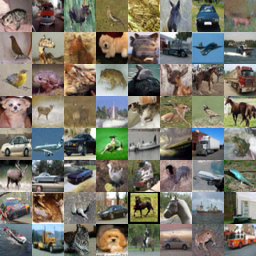

In [9]:
rec_np = (x_0 * 127.5 + 128).clip(0, 255).to(torch.uint8).permute(0, 2, 3, 1).cpu().numpy()
n = len(rec_np)
m = int(np.ceil(np.sqrt(n)))
w = h = net.img_resolution
grid = np.zeros((m*h, m*w, 3), dtype=np.uint8)
for i, i_np in enumerate(rec_np):
    x, y = i%m, i//m
    grid[y*h:(y+1)*h, x*w:(x+1)*w, :] = i_np
    
image_grid = PIL.Image.fromarray(grid, 'RGB') 
image_grid.save(f'{directory_path}/HKD_x0.png')
display(image_grid)

### Figure 2: Visulize the reverse diffusion process

/tmp/ipykernel_2908842/1033536205.py:15: DeprecationWarning: 'mode' parameter is deprecated and will be removed in Pillow 13 (2026-10-15)
  image_grid = PIL.Image.fromarray(grid, 'RGB')


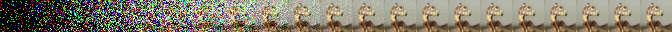

/tmp/ipykernel_2908842/1033536205.py:22: DeprecationWarning: 'mode' parameter is deprecated and will be removed in Pillow 13 (2026-10-15)
  image_grid1 = PIL.Image.fromarray(grid, 'RGB')


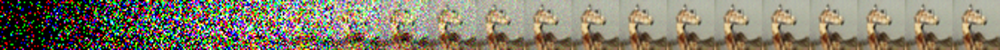

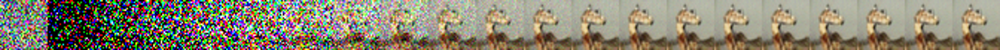

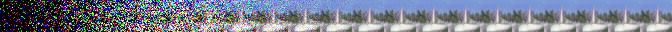

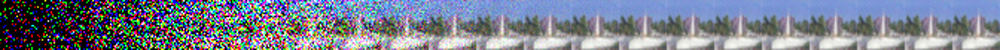

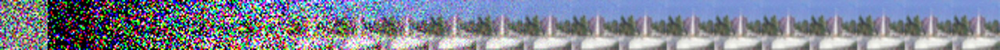

...

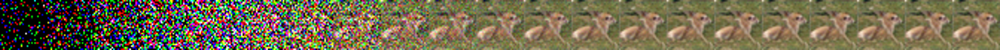

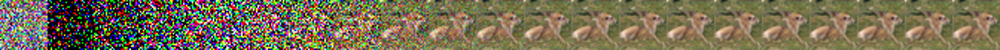

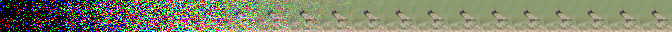

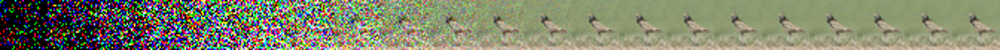

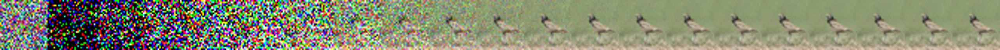

In [ ]:
x_step_np = [(i * 127.5 + 128).clip(0, 255).to(torch.uint8).permute(0, 2, 3, 1).cpu().numpy() for i in x_step]
xhat_step_np = [(i * 127.5 + 128).clip(0, 255).to(torch.uint8).permute(0, 2, 3, 1).cpu().numpy() for i in xhat_step]
for idx in (9,27,54,29,30):
    n = len(x_step_np)
    L = 20
    m = int(n/L)
    w = h = net.img_resolution
    grid = np.zeros((h, (L+1)*w, 3), dtype=np.uint8)
    for i, i_np in enumerate(x_step_np):
        if i==0 or i%m==0:
            grid[0:h, int(i/m)*w:(int(i/m)+1)*w, :] = i_np[idx]    
    image_grid = PIL.Image.fromarray(grid, 'RGB')    
    

    display(image_grid)
    for i, i_np in enumerate(xhat_step_np):
        if i==0 or i%m==0:
            grid[0:h, int(i/m)*w:(int(i/m)+1)*w, :] = i_np[idx] 
    image_grid1 = PIL.Image.fromarray(grid, 'RGB')

    image_grid.save(f'{directory_path}/image{idx}.png')
    image_grid1.save(f'{directory_path}/image{idx}_1.png')

    resized_image_grid = image_grid.resize((128*L,128))
    resized_image_grid1 = image_grid1.resize((128*L,128))
    display(resized_image_grid)
    display(resized_image_grid1)